# **Closest TTC Stations - A Voronoi Diagram**
## Author: Rohan Dawar
## Email: dawar.rohan1@gmail.com
## Website: [rohandawar.com](https://rohandawar.com)
## GitHub: [Rohan-Dawar](https://github.com/Rohan-Dawar)



Creating voronoi polygons for Toronto's TTC stations.

* [ What is a Voronoi Diagram?](https://en.wikipedia.org/wiki/Voronoi_diagram)

* [Geovoronoi](https://pypi.org/project/geovoronoi/): A python package for creating Voronoi Polygons

* [The Toronto Subway System (TTC)](https://en.wikipedia.org/wiki/List_of_Toronto_subway_stations)

Uploaded Files:
This notebook requires shapefiles from [Canada Gov Shapefile](https://open.canada.ca/data/en/dataset/a883eb14-0c0e-45c4-b8c4-b54c4a819edb)

# Dependencies

## After the first cell with !pip install geovoronoi, the runtime must be restarted

In [1]:
!pip install -U geovoronoi[plotting]

     |████████████████████████████████| 27.4 MB 91 kB/s 
     |████████████████████████████████| 962 kB 74.7 MB/s 
     |████████████████████████████████| 11.5 MB 12 kB/s 
     |████████████████████████████████| 6.6 MB 18.2 MB/s 
     |████████████████████████████████| 15.4 MB 37 kB/s 
  Attempting uninstall: scipy
    Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.2.2
    Uninstalling matplotlib-3.2.2:
      Successfully uninstalled matplotlib-3.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [1]:
!pip install geopandas
!pip install descartes

In [2]:
import pandas as pd
import numpy as np
import requests
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
from shapely.geometry import Point
import geopandas as gpd
import folium

from geovoronoi.plotting import subplot_for_map, plot_voronoi_polys_with_points_in_area
from geovoronoi import voronoi_regions_from_coords, points_to_coords

# Wikipedia Page to Dataframe

In [3]:
url = 'https://en.wikipedia.org/wiki/List_of_Toronto_subway_stations'

In [4]:
existing = pd.read_html(url)[1]

# Parsing wikipedia page links for each station
* this is done because latitude & longitude coordinates are only available on the station wikipedia pages, not the top level list

In [5]:
response = requests.get(url)
soup = BeautifulSoup(response.text, 'html.parser')
table = soup.find_all('table')[1]

links = []
for tr in table.findAll("tr"):
  trs = tr.findAll("th", scope='row')
  for each in trs:
      try:
          link = each.find('a')['href']
          links.append(link)
      except:
          pass

In [6]:
existing['Link'] = links

# Getting coordinates for each station

In [7]:
base_url = 'https://en.wikipedia.org'

def get_coords(link):
  r = requests.get(base_url + link)
  soup = BeautifulSoup(r.text, 'html.parser')
  coordstring = soup.find(class_="geo").text.strip()
  tuplestring = tuple(map(float, coordstring.split(';')))
  return (tuplestring[1], tuplestring[0])

In [8]:
existing['coords'] = existing['Link'].apply(get_coords)

In [9]:
existing

,Station,Line,Grade,Opened[6],Ridership (2018[7] Avg. Weekday),Platforms,Parking Spaces[8],Terminal within fare-paid area,Transfers[9],Accessible[3],Link,coords
0,Finch,NaN,Underground,1974,99350,Centre,3214,Yes,TTC buses Finch BusTerminal York Region Tran...,Yes,/wiki/Finch_station,"(-79.41472, 43.78056)"
1,North York Centre,NaN,Underground,1987,25380,Side,0,No,TTC buses,Yes,/wiki/North_York_Centre_station,"(-79.41278, 43.76833)"
2,Sheppard–Yonge,NaN,Underground,"1974, 2002",125470,"Centre, Side(roughed-in .mw-parser-output .too...",0,Yes,TTC buses,Yes,/wiki/Sheppard%E2%80%93Yonge_station,"(-79.41083, 43.76139)"
3,York Mills,NaN,Underground,1973,29660,Centre,260,Yes,TTC buses GO Transit bus services,Yes,/wiki/York_Mills_station,"(-79.40667, 43.74417)"
4,Lawrence,NaN,Underground,1973,22340,Centre,0,Yes,TTC buses,No,/wiki/Lawrence_station_(Toronto),"(-79.40222, 43.725)"
...,...,...,...,...,...,...,...,...,...,...,...,...
70,McCowan,NaN,Elevated,1985,3860,Side,0,No,TTC buses,No,/wiki/McCowan_station,"(-79.25167, 43.774917)"
71,Bayview,NaN,Underground,2002,8530,Centre,0,No,TTC buses,Yes,/wiki/Bayview_station_(Toronto),"(-79.38667, 43.76694)"
72,Bessarion,NaN,Underground,2002,2990,Centre,0,No,TTC buses,Yes,/wiki/Bessarion_station,"(-79.37639, 43.76917)"
73,Leslie,NaN,Underground,2002,5990,Centre,102,Yes,TTC buses Richmond Hill,Yes,/wiki/Leslie_station,"(-79.36528, 43.77139)"


# Getting TTC Colors:

In [10]:
COLurl = 'https://en.wikipedia.org/wiki/Template:TTC_color'

In [11]:
colorHash = pd.read_html(COLurl)[1]

In [12]:
websafeCOLS = {colorHash['Color.2'][i]: colorHash['Web-safeHexadecimal.1'][i] for i in range(len(colorHash))}

In [13]:
colorHash = colorHash[1:6]

In [14]:
colorHash = colorHash['Color.2'].to_dict()

# Assigning Lines & Color

In [15]:
response = requests.get(url)
soup = BeautifulSoup(response.text, 'html.parser')
table = soup.find_all('table')[1]

lines = []
for tr in table.findAll("tr"):
  trs = tr.findAll("td")
  for each in trs:
      try:
          link = each.find('a')['href']
          if link.split('/wiki/')[1][0:4] == 'Line':
            lines.append(link)
      except:
        pass

In [16]:
existing['LineLink'] = lines[1:]

In [17]:
def extractLineNO(LineLink):
  return int(LineLink.split('/wiki/Line_')[1][0])

In [18]:
existing['LineNO'] = existing['LineLink'].apply(extractLineNO)

In [19]:
existing['COL'] = existing['LineNO'].map(colorHash)

In [20]:
existing

,Station,Line,Grade,Opened[6],Ridership (2018[7] Avg. Weekday),Platforms,Parking Spaces[8],Terminal within fare-paid area,Transfers[9],Accessible[3],Link,coords,LineLink,LineNO,COL
0,Finch,NaN,Underground,1974,99350,Centre,3214,Yes,TTC buses Finch BusTerminal York Region Tran...,Yes,/wiki/Finch_station,"(-79.41472, 43.78056)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
1,North York Centre,NaN,Underground,1987,25380,Side,0,No,TTC buses,Yes,/wiki/North_York_Centre_station,"(-79.41278, 43.76833)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
2,Sheppard–Yonge,NaN,Underground,"1974, 2002",125470,"Centre, Side(roughed-in .mw-parser-output .too...",0,Yes,TTC buses,Yes,/wiki/Sheppard%E2%80%93Yonge_station,"(-79.41083, 43.76139)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
3,York Mills,NaN,Underground,1973,29660,Centre,260,Yes,TTC buses GO Transit bus services,Yes,/wiki/York_Mills_station,"(-79.40667, 43.74417)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
4,Lawrence,NaN,Underground,1973,22340,Centre,0,Yes,TTC buses,No,/wiki/Lawrence_station_(Toronto),"(-79.40222, 43.725)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70,McCowan,NaN,Elevated,1985,3860,Side,0,No,TTC buses,No,/wiki/McCowan_station,"(-79.25167, 43.774917)",/wiki/Line_3_Scarborough,3,1F99D5
71,Bayview,NaN,Underground,2002,8530,Centre,0,No,TTC buses,Yes,/wiki/Bayview_station_(Toronto),"(-79.38667, 43.76694)",/wiki/Line_4_Sheppard,4,B32078
72,Bessarion,NaN,Underground,2002,2990,Centre,0,No,TTC buses,Yes,/wiki/Bessarion_station,"(-79.37639, 43.76917)",/wiki/Line_4_Sheppard,4,B32078
73,Leslie,NaN,Underground,2002,5990,Centre,102,Yes,TTC buses Richmond Hill,Yes,/wiki/Leslie_station,"(-79.36528, 43.77139)",/wiki/Line_4_Sheppard,4,B32078


# Shapefile & Geopandas geodf

In [21]:
canada = gpd.read_file('/content/lpr_000b16a_e.shp')
canada = canada.to_crs('WGS84')

In [22]:
ontario = canada[canada['PRNAME'] == 'Ontario']
ontariogeo = ontario.iloc[0]['geometry']

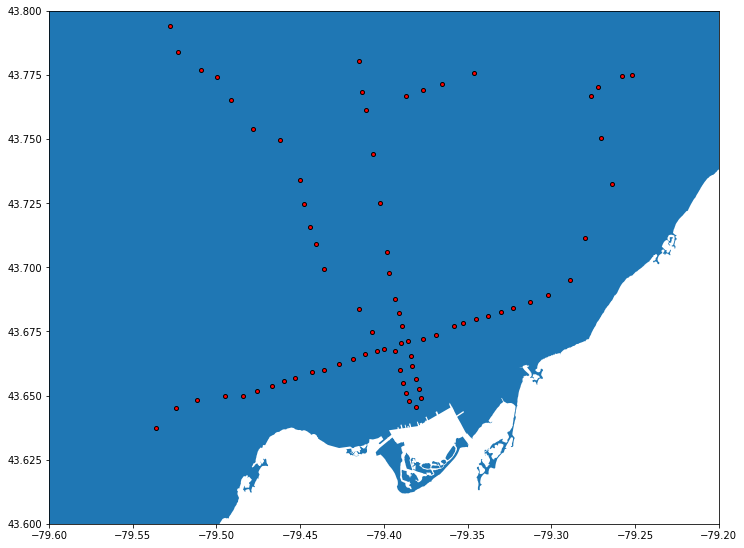

In [23]:
fig, ax = plt.subplots(figsize=(12,12))
ontario.plot(ax=ax)
ax.set_xlim(-79.6,-79.2)
ax.set_ylim(43.6,43.8)

for i in range(len(existing)):
  d = existing.iloc[i]
  cds = d['coords']
  ax.plot(cds[0], cds[1],  marker='o', markersize=4, color='red', markeredgecolor='black', alpha=1, zorder=10)

In [ ]:
arcords = np.array(list(map(list, existing['coords'].tolist())))

# Voronoi Polygons

In [ ]:
region_polys, region_pts = voronoi_regions_from_coords(arcords, ontariogeo)

(43.6, 43.8)

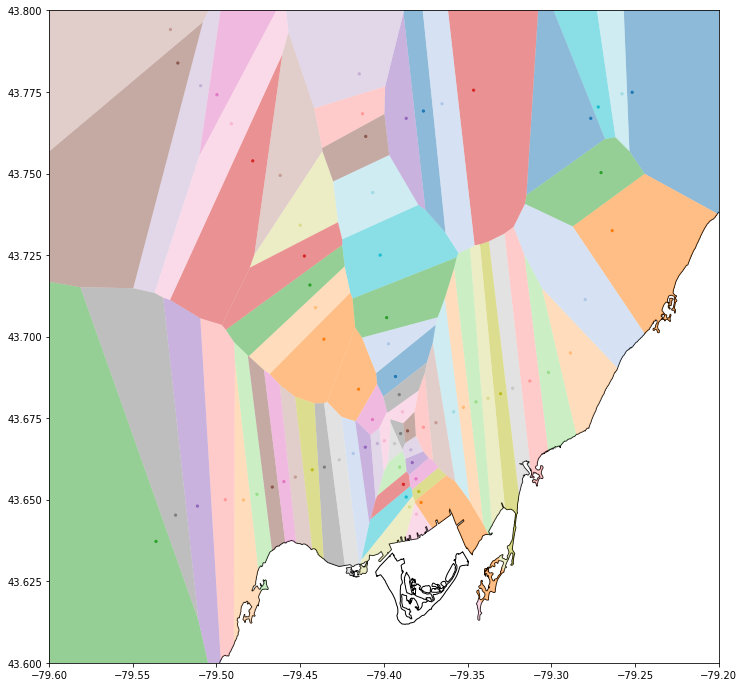

In [ ]:
fig, ax = plt.subplots(figsize=(12,12))

plot_voronoi_polys_with_points_in_area(ax, ontariogeo, region_polys, arcords, region_pts)
ax.set_xlim(-79.6,-79.2)
ax.set_ylim(43.6,43.8)

# Folium

In [ ]:
existing

,Station,Line,Grade,Opened[6],Ridership (2018[7] Avg. Weekday),Platforms,Parking Spaces[8],Terminal within fare-paid area,Transfers[9],Accessible[3],Link,coords,LineLink,LineNO,COL
0,Finch,NaN,Underground,1974,99350,Centre,3214,Yes,TTC buses Finch BusTerminal York Region Tran...,Yes,/wiki/Finch_station,"(-79.41472, 43.78056)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
1,North York Centre,NaN,Underground,1987,25380,Side,0,No,TTC buses,Yes,/wiki/North_York_Centre_station,"(-79.41278, 43.76833)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
2,Sheppard–Yonge,NaN,Underground,"1974, 2002",125470,"Centre, Side(roughed-in .mw-parser-output .too...",0,Yes,TTC buses,Yes,/wiki/Sheppard%E2%80%93Yonge_station,"(-79.41083, 43.76139)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
3,York Mills,NaN,Underground,1973,29660,Centre,260,Yes,TTC buses GO Transit bus services,Yes,/wiki/York_Mills_station,"(-79.40667, 43.74417)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
4,Lawrence,NaN,Underground,1973,22340,Centre,0,Yes,TTC buses,No,/wiki/Lawrence_station_(Toronto),"(-79.40222, 43.725)",/wiki/Line_1_Yonge%E2%80%93University,1,FFCB0C
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70,McCowan,NaN,Elevated,1985,3860,Side,0,No,TTC buses,No,/wiki/McCowan_station,"(-79.25167, 43.774917)",/wiki/Line_3_Scarborough,3,1F99D5
71,Bayview,NaN,Underground,2002,8530,Centre,0,No,TTC buses,Yes,/wiki/Bayview_station_(Toronto),"(-79.38667, 43.76694)",/wiki/Line_4_Sheppard,4,B32078
72,Bessarion,NaN,Underground,2002,2990,Centre,0,No,TTC buses,Yes,/wiki/Bessarion_station,"(-79.37639, 43.76917)",/wiki/Line_4_Sheppard,4,B32078
73,Leslie,NaN,Underground,2002,5990,Centre,102,Yes,TTC buses Richmond Hill,Yes,/wiki/Leslie_station,"(-79.36528, 43.77139)",/wiki/Line_4_Sheppard,4,B32078


In [ ]:
m = folium.Map(location=[43.65, -79.4], zoom_start=13, tiles='CartoDB positron')

In [ ]:
# Polys:

for count, r in enumerate(region_polys.values()):
  dfindex = region_pts[count][0]
  d = existing.loc[dfindex]
  col = d['COL']
  websafecol = '#' + websafeCOLS[col]
  name = d['Station']
  opened = d['Opened[6]']
  rdshp = d['Ridership (2018[7] Avg. Weekday)']

  popup = f'{name} Station\nOpened: {opened}\nRidership (2018, weekday): {rdshp}'

  geo_j = folium.GeoJson(data=r, style_function=lambda x: {'fillColor': websafecol, 'color' : 'silver'}, tooltip = name)
  folium.Popup(popup).add_to(geo_j)
  geo_j.add_to(m)

In [ ]:
# Points:

for i in range(len(existing)):
  d = existing.iloc[i]
  cds = d['coords']
  name = d['Station']
  col = d['COL']


  folium.Circle(
    radius=50,
    location=[cds[1], cds[0]],
    popup = name,
    color = f'#{col}',
    fill=True,
    tooltip = name).add_to(m)

In [ ]:
m

In [ ]:
m.save("voronoiTTC.html")

# Adding Line 5:

In [ ]:
uc = pd.read_html(url)[3]

In [ ]:
uc = uc[:22]

In [ ]:
response = requests.get(url)
soup = BeautifulSoup(response.text, 'html.parser')
table = soup.find_all('table')[3]

links = []
for tr in table.findAll("tr"):
  trs = tr.findAll("th", scope='row')
  for each in trs:
      try:
          link = each.find('a')['href']
          links.append(link)
      except:
          pass

In [ ]:
links = links[:-1]

In [ ]:
uc['Links'] = links

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
uc['coords'] = uc['Links'].apply(get_coords)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
uc

,Station,Line,Grade,Opening[14],Platforms[15][16],Parking spaces,Terminal within station,Proposed transfers[17],Links,coords
0,Mount Dennis,NaN,At grade,2022,Centre,NaN,Yes,TTC buses Kitchener Union Pearson Express,/wiki/Mount_Dennis_station,"(-79.48722, 43.6875)"
1,Keelesdale,NaN,Underground,2022,Centre,NaN,Yes,TTC buses,/wiki/Keelesdale_station,"(-79.475, 43.69028)"
2,Caledonia,NaN,Underground,2022,Centre,NaN,Yes,TTC buses Barrie,/wiki/Caledonia_station,"(-79.46556, 43.69222)"
3,Fairbank,NaN,Underground,2022,Centre,NaN,No,TTC buses,/wiki/Fairbank_station,"(-79.45, 43.69556)"
4,Oakwood,NaN,Underground,2022,Centre,NaN,No,TTC buses,/wiki/Oakwood_station_(Toronto),"(-79.44306, 43.69722)"
5,Forest Hill,NaN,Underground,2022,Centre,NaN,No,TTC buses,/wiki/Forest_Hill_station_(Toronto),"(-79.42528, 43.70111)"
6,Chaplin,NaN,Underground,2022,Centre,NaN,No,TTC buses,/wiki/Chaplin_station,"(-79.41722, 43.70278)"
7,Avenue,NaN,Underground,2022,Centre,NaN,No,TTC buses,/wiki/Avenue_station,"(-79.40778, 43.70472)"
8,Mount Pleasant,NaN,Underground,2022,Centre,NaN,No,TTC buses,/wiki/Mount_Pleasant_station_(Toronto),"(-79.390167, 43.708389)"
9,Leaside,NaN,Underground,2022,Centre,NaN,No,TTC buses,/wiki/Leaside_station,"(-79.37694, 43.71111)"


In [ ]:
extendedARcords = np.append(arcords, np.array(list(map(list, uc['coords'].tolist()))), 0)

In [ ]:
region_polys, region_pts = voronoi_regions_from_coords(extendedARcords, ontariogeo)

In [ ]:
m2 = folium.Map(location=[43.65, -79.4], zoom_start=13, tiles='CartoDB positron')

In [ ]:
# Polys:
for count, r in enumerate(region_polys.values()):
  geo_j = folium.GeoJson(data=r)
  geo_j.add_to(m2)

In [ ]:
# Points:
for i in extendedARcords:
  folium.Circle(radius=50, location= (i[1], i[0]) ).add_to(m2)

In [ ]:
m2